**Glioblastoma Detection**

*Import Library*

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import os
import glob
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, roc_curve
import seaborn as sns

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers, models
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

import kagglehub

2025-12-11 08:16:38.447026: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-12-11 08:16:38.470539: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F AVX512_VNNI AVX512_BF16 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-12-11 08:16:38.930788: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
/home/filkom/nada_tif/venv/lib/python3.13/site-packages/tqd

In [2]:
# Set random seeds untuk reproducibility
np.random.seed(42)
tf.random.set_seed(42)

# Konfigurasi GPU
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
    except RuntimeError as e:
        print(e)

W0000 00:00:1765440999.064844 1831761 gpu_device.cc:2342] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


Konfigurasi Projek

In [3]:
print("Downloading dataset from Kaggle...")
path = kagglehub.dataset_download("fernando2rad/brain-tumor-mri-images-44c")
print("Path to dataset files:", path)

Path to dataset files: /home/filkom/.cache/kagglehub/datasets/fernando2rad/brain-tumor-mri-images-44c/versions/1


In [4]:
class Config:
    DATA_PATH = path  # Path dari kagglehub
    
    # Rasio split dataset
    TRAIN_RATIO = 0.7
    VAL_RATIO = 0.15
    TEST_RATIO = 0.15
    
    # Parameter
    IMG_SIZE = (224, 224)
    BATCH_SIZE = 16
    EPOCHS = 500
    
    # Class names - 15 kelas berdasarkan penyakit
    CLASSES = [
        'Astrocitoma',
        'Carcinoma',
        'Ependimoma',
        'Ganglioglioma',
        'Germinoma',
        'Glioblastoma',
        'Granuloma',
        'Meduloblastoma',
        'Meningioma',
        'Neurocitoma',
        'Oligodendroglioma',
        'Papiloma',
        'Schwannoma',
        'Tuberculoma',
        'NORMAL'
    ]
    NUM_CLASSES = len(CLASSES)

config = Config()

Load Data

In [5]:
def extract_disease_name(folder_name):
    if folder_name.startswith('_'):
        folder_name = folder_name[1:]
    
    disease = folder_name.split(' ')[0]
    
    return disease

In [6]:
def load_data():
    data = []
    
    # List semua folder di dataset
    all_folders = [f for f in os.listdir(config.DATA_PATH) 
                   if os.path.isdir(os.path.join(config.DATA_PATH, f))]

    # Counter untuk tracking
    disease_counts = {}
    
    for folder in all_folders:
        folder_path = os.path.join(config.DATA_PATH, folder)
        
        # Ekstrak nama penyakit
        disease = extract_disease_name(folder)
        
        # Skip jika penyakit tidak ada dalam daftar kelas
        if disease not in config.CLASSES:
            print(f"Warning: '{disease}' from folder '{folder}' not in CLASSES list, skipping...")
            continue
        
        # Ambil semua file gambar dari folder
        image_extensions = ['*.jpg', '*.jpeg', '*.png', '*.bmp', '*.tif', '*.tiff']
        files = []
        for ext in image_extensions:
            files.extend(glob.glob(os.path.join(folder_path, ext)))
        
        # Tambahkan ke data
        for file in files:
            data.append({
                'filepath': file,
                'label': disease,
                'original_folder': folder
            })
        
        # Update counter
        if disease not in disease_counts:
            disease_counts[disease] = 0
        disease_counts[disease] += len(files)
        
        print(f"  {folder} -> {disease}: {len(files)} images")
    
    print(f"\nTotal images loaded: {len(data)}")
    print("\nDistribusi per kelas:")
    for disease in sorted(disease_counts.keys()):
        print(f"  {disease}: {disease_counts[disease]} images")
    
    # Buat DataFrame
    df = pd.DataFrame(data)
    
    # Cek apakah ada data
    if len(df) == 0:
        raise ValueError("No data loaded! Please check the dataset path and folder structure.")
    
    # Split data: train, validation, test
    train_df, test_val_df = train_test_split(
        df,
        test_size=1 - config.TRAIN_RATIO,
        stratify=df['label'],
        random_state=42
    )
    
    val_df, test_df = train_test_split(
        test_val_df,
        test_size=config.TEST_RATIO/(config.TEST_RATIO + config.VAL_RATIO),
        stratify=test_val_df['label'],
        random_state=42
    )
    
    # Tambahkan kolom split
    train_df['split'] = 'train'
    val_df['split'] = 'val'
    test_df['split'] = 'test'
    
    print(f"\nData split:")
    print(f"  Train: {len(train_df)} images")
    print(f"  Validation: {len(val_df)} images")
    print(f"  Test: {len(test_df)} images")
    
    return pd.concat([train_df, val_df, test_df], ignore_index=True)

**Preprocessing pipeline**

In [7]:
def clahe(image):
    clahe = cv2.createCLAHE(clipLimit=3.0, tileGridSize=(16, 16))
    enhanced = clahe.apply(image)
    return enhanced

def denoise(image):
    denoised = cv2.fastNlMeansDenoising(image, None, 15, 7, 21)
    return denoised

def skull_stripping(image):
    h, w = image.shape[:2]
    
    _, binary = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    
    kernel = np.ones((3, 3), np.uint8)
    eroded = cv2.erode(binary, kernel, iterations=2)
    dilated = cv2.dilate(eroded, kernel, iterations=3)
    
    num_labels, labels, stats, _ = cv2.connectedComponentsWithStats(
        dilated, connectivity=4, ltype=cv2.CV_32S
    )

    if num_labels > 1:
        areas = stats[1:, cv2.CC_STAT_AREA]
        largest_label = 1 + np.argmax(areas)
        brain_mask = (labels == largest_label).astype(np.uint8) * 255
        
        min_area = (h * w) * 0.01
        if stats[largest_label, cv2.CC_STAT_AREA] < min_area:
            brain_mask = dilated
    else:
        brain_mask = dilated
    
    result = cv2.bitwise_and(image, image, mask=brain_mask)
    
    return result

def intensity_normalization(image):
    i_min = np.min(image)
    i_max = np.max(image)
    
    if i_max - i_min > 0:
        normalized = ((image - i_min) / (i_max - i_min) * 255).astype(np.uint8)
    else:
        normalized = image.astype(np.uint8)
    
    return normalized

In [8]:
def create_data_generators(df, prepro):
    df['filepath'] = df['filepath'].astype(str)

    train_df = df[df['split'] == 'train'].copy()
    val_df = df[df['split'] == 'val'].copy()
    test_df = df[df['split'] == 'test'].copy()

    def preprocessing_wrapper(img):
        if len(img.shape) == 3:
            gray = cv2.cvtColor(img.astype(np.uint8), cv2.COLOR_RGB2GRAY)
        else:
            gray = img.astype(np.uint8)
        
        if prepro == "clahe":
            gray = clahe(gray)
        elif prepro == "denoise":
            gray = denoise(gray)
        elif prepro == "skull_stripping":
            gray = skull_stripping(gray)
        elif prepro == "intensity_normalization":
            gray = intensity_normalization(gray)

        img_rgb = cv2.cvtColor(gray, cv2.COLOR_GRAY2RGB)
        
        return img_rgb.astype(np.float32)

    train_datagen = ImageDataGenerator(
        rotation_range=15,
        width_shift_range=0.1,
        height_shift_range=0.1,
        horizontal_flip=True,
        vertical_flip=False,
        zoom_range=0.1,
        brightness_range=[0.8, 1.2],
        fill_mode='nearest',
        preprocessing_function=preprocessing_wrapper if prepro != "base" else None
    )
    
    val_test_datagen = ImageDataGenerator()

    # Generator untuk masing-masing set
    train_generator = train_datagen.flow_from_dataframe(
        train_df,
        x_col='filepath',
        y_col='label',
        target_size=config.IMG_SIZE,
        batch_size=config.BATCH_SIZE,
        class_mode='categorical',
        shuffle=True
    )
    
    val_generator = val_test_datagen.flow_from_dataframe(
        val_df,
        x_col='filepath',
        y_col='label',
        target_size=config.IMG_SIZE,
        batch_size=config.BATCH_SIZE,
        class_mode='categorical',
        shuffle=False
    )
    
    test_generator = val_test_datagen.flow_from_dataframe(
        test_df,
        x_col='filepath',
        y_col='label',
        target_size=config.IMG_SIZE,
        batch_size=config.BATCH_SIZE,
        class_mode='categorical',
        shuffle=False
    )

    return train_generator, val_generator, test_generator

In [9]:
def build_model(input_shape=(224,224,3), num_classes=config.NUM_CLASSES):
    base_model = EfficientNetB0(
        weights='imagenet',
        include_top=False,
        input_shape=input_shape
    )

    for layer in base_model.layers:
        layer.trainable = False
    
    x = base_model.output
    x = layers.GlobalAveragePooling2D()(x)
    x = layers.Dense(256, activation='relu')(x)
    x = layers.Dropout(0.5)(x)
    x = layers.Dense(128, activation='relu')(x)
    x = layers.Dropout(0.3)(x)
    predictions = layers.Dense(num_classes, activation='softmax')(x)
    
    model = models.Model(inputs=base_model.input, outputs=predictions)
    return model

In [10]:
def compile_and_train_model(model, train_generator, val_generator, epochs=500):
    model.compile(
        optimizer=keras.optimizers.Adam(learning_rate=0.0001),
        loss='categorical_crossentropy',
        metrics=['accuracy', keras.metrics.Precision(name='precision'),
                keras.metrics.Recall(name='recall')]
    )

    # Callbacks
    early_stopping = EarlyStopping(
        monitor='val_loss',
        patience=10,
        restore_best_weights=True,
        verbose=1
    )
    reduce_lr = ReduceLROnPlateau(
        monitor='val_loss',
        factor=0.5,
        patience=5,
        min_lr=0.00001,
        verbose=1
    )

    # Train model
    history = model.fit(
        train_generator,
        epochs=epochs,
        validation_data=val_generator,
        callbacks=[early_stopping, reduce_lr],
        verbose=1
    )

    # Dapatkan epoch terbaik dari early stopping
    best_epoch = early_stopping.stopped_epoch - early_stopping.patience + 1
    if best_epoch < 0:
        best_epoch = len(history.history['val_loss']) - 1

    print(f"\nTraining stopped at epoch {early_stopping.stopped_epoch + 1}")
    print(f"Best model at epoch {best_epoch + 1}")

    return model, history, best_epoch

Model dibuat dengan Transfer learning dengan ResNet50 pre-trained pada ImageNet,
dan tidak dilatih ulang. Layer Global Average Pooling untuk mengurangi dimensi
Dua Dense layers (256 dan 128 neurons) dengan ReLU activation. dan layer Dropout (0.5 dan 0.3) untuk mencegah overfitting. lalu Output layer dengan softmax untuk klasifikasi 2 kelas

In [11]:
def make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_index=None):
    grad_model = models.Model(
        inputs=[model.inputs],
        outputs=[model.get_layer(last_conv_layer_name).output, model.output]
    )
    
    with tf.GradientTape() as tape:
        last_conv_layer_output, preds = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(preds[0])
        class_channel = preds[:, pred_index]
    
    grads = tape.gradient(class_channel, last_conv_layer_output)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    
    last_conv_layer_output = last_conv_layer_output[0]
    heatmap = last_conv_layer_output @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

def apply_gradcam_overlay(img, heatmap, alpha=0.4, threshold=0.5):
    heatmap = cv2.resize(heatmap, (img.shape[1], img.shape[0]))
    heatmap_thresholded = np.where(heatmap >= threshold, heatmap, 0)
    
    if heatmap_thresholded.max() > 0:
        heatmap_thresholded = (heatmap_thresholded - heatmap_thresholded.min()) / \
                              (heatmap_thresholded.max() - heatmap_thresholded.min())
    
    heatmap_colored = np.uint8(255 * heatmap_thresholded)
    heatmap_colored = cv2.applyColorMap(heatmap_colored, cv2.COLORMAP_JET)
    
    mask = (heatmap >= threshold).astype(np.float32)
    mask = np.stack([mask] * 3, axis=-1)
    
    superimposed_img = heatmap_colored * alpha * mask + img * (1 - alpha * mask)
    superimposed_img = np.clip(superimposed_img, 0, 255).astype(np.uint8)
    
    return superimposed_img

def visualize_gradcam_preprocessing(df, model, prepro="base", threshold=0.5, samples_per_class=2):
    last_conv_layer_name = None
    for layer in reversed(model.layers):
        if len(layer.output.shape) == 4:
            last_conv_layer_name = layer.name
            break
    
    if last_conv_layer_name is None:
        print("Could not find convolutional layer in model")
        return
    
    print(f"Using layer '{last_conv_layer_name}' for Grad-CAM")
    print(f"Activation threshold: {threshold} (Red/Yellow = High importance)")
    
    # Select samples per class
    samples = []
    available_classes = df['label'].unique()
    
    for class_name in config.CLASSES:
        if class_name in available_classes:
            class_samples = df[df['label'] == class_name].head(samples_per_class)
            samples.extend([(path, label) for path, label in zip(
                class_samples['filepath'].tolist(),
                class_samples['label'].tolist()
            )])
    
    if len(samples) == 0:
        print("No samples found for visualization")
        return
    
    # Create layout
    num_rows = min(len(config.CLASSES), len(available_classes))
    fig, axes = plt.subplots(num_rows, 4, figsize=(20, 5*num_rows))
    
    if num_rows == 1:
        axes = axes.reshape(1, -1)
    
    sample_idx = 0
    for class_idx, class_name in enumerate(config.CLASSES):
        if class_idx >= num_rows:
            break
            
        if class_name not in available_classes:
            continue
            
        for col_pair in range(min(2, samples_per_class)):
            if sample_idx >= len(samples):
                break
                
            image_path, label = samples[sample_idx]
            
            try:
                original = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
                if original is None:
                    print(f"Warning: Could not read image {image_path}")
                    sample_idx += 1
                    continue
                
                img_resized = cv2.resize(original, config.IMG_SIZE, interpolation=cv2.INTER_AREA)
                img_rgb = cv2.cvtColor(img_resized, cv2.COLOR_GRAY2RGB)
                
                img_array = np.expand_dims(img_rgb, axis=0).astype(np.float32)
                
                preds = model.predict(img_array, verbose=0)
                pred_class_idx = np.argmax(preds[0])
                pred_class_name = list(model.layers[-1].output.shape)[1]
                pred_class_name = config.CLASSES[pred_class_idx]
                confidence = preds[0][pred_class_idx] * 100
                
                heatmap = make_gradcam_heatmap(img_array, model, last_conv_layer_name, pred_class_idx)
                
                img_col = col_pair * 2
                pred_col = col_pair * 2 + 1
                
                gradcam_overlay = apply_gradcam_overlay(img_rgb, heatmap, alpha=0.5, threshold=threshold)
                axes[class_idx, img_col].imshow(gradcam_overlay)
                axes[class_idx, img_col].set_title(f'{label}\nSample {col_pair+1}', 
                                                   fontsize=11, fontweight='bold')
                axes[class_idx, img_col].axis('off')
                
                is_correct = (label == pred_class_name)
                box_color = 'lightgreen' if is_correct else 'lightcoral'
                
                axes[class_idx, pred_col].text(0.5, 0.5, 
                                              f'True:\n{label}\n\n' + 
                                              f'Pred:\n{pred_class_name}\n\n' + 
                                              f'Conf:\n{confidence:.1f}%\n\n' + 
                                              f'{"✓" if is_correct else "✗"}',
                                              ha='center', va='center', fontsize=12, 
                                              bbox=dict(boxstyle='round', facecolor=box_color, alpha=0.8, pad=0.8))
                axes[class_idx, pred_col].axis('off')
                axes[class_idx, pred_col].set_title('Prediction', fontsize=11, fontweight='bold')
                
            except Exception as e:
                print(f"Error processing image {image_path}: {str(e)}")
            
            sample_idx += 1
    
    fig.suptitle(f'Grad-CAM Visualization - {prepro.upper()} (Threshold: {threshold})', 
                 fontsize=15, fontweight='bold', y=0.98)
    
    plt.tight_layout()
    plt.show()

**Visualisasi**

In [12]:
def visualize_preprocessing(df, samples_per_class=1):
    samples = []
    available_classes = df['label'].unique()
    
    for class_name in config.CLASSES:
        if class_name in available_classes:
            class_samples = df[df['label'] == class_name].head(samples_per_class)
            samples.extend(class_samples['filepath'].tolist())

    if len(samples) == 0:
        print("No samples found for preprocessing visualization")
        return

    fig, axes = plt.subplots(len(samples), 6, figsize=(20, 4*len(samples)))
    
    if len(samples) == 1:
        axes = axes.reshape(1, -1)

    for idx, image_path in enumerate(samples):
        try:
            # Original
            original = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
            if original is None:
                print(f"Warning: Could not read image {image_path}")
                continue
                
            axes[idx, 0].imshow(original, cmap='gray')
            axes[idx, 0].set_title('Original')
            axes[idx, 0].axis('off')

            # CLAHE
            clahe_img = clahe(original)
            axes[idx, 1].imshow(clahe_img, cmap='gray')
            axes[idx, 1].set_title('After CLAHE')
            axes[idx, 1].axis('off')

            # Denoised
            denoised_img = denoise(original)
            axes[idx, 2].imshow(denoised_img, cmap='gray')
            axes[idx, 2].set_title('After Denoise')
            axes[idx, 2].axis('off')

            # Skull stripped
            skull_stripped = skull_stripping(original)
            axes[idx, 3].imshow(skull_stripped, cmap='gray')
            axes[idx, 3].set_title('After Skull Strip')
            axes[idx, 3].axis('off')

            # Normalized
            normalized = intensity_normalization(original)
            axes[idx, 4].imshow(normalized, cmap='gray')
            axes[idx, 4].set_title('After Normalization')
            axes[idx, 4].axis('off')

            # Final (resized and RGB)
            final = cv2.resize(original, config.IMG_SIZE)
            final_rgb = cv2.cvtColor(final, cv2.COLOR_GRAY2RGB)
            axes[idx, 5].imshow(final_rgb)
            axes[idx, 5].set_title('Final (RGB)')
            axes[idx, 5].axis('off')
        except Exception as e:
            print(f"Error processing image {image_path}: {str(e)}")

    plt.tight_layout()
    plt.show()

In [13]:
def plot_training_history(history, best_epoch):
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))

    # Accuracy
    axes[0, 0].plot(history.history['accuracy'], label='Train Accuracy')
    axes[0, 0].plot(history.history['val_accuracy'], label='Val Accuracy')
    axes[0, 0].axvline(x=best_epoch, color='r', linestyle='--', label=f'Best Epoch ({best_epoch+1})')
    axes[0, 0].set_title('Model Accuracy')
    axes[0, 0].set_xlabel('Epoch')
    axes[0, 0].set_ylabel('Accuracy')
    axes[0, 0].legend()
    axes[0, 0].grid(True)

    # Loss
    axes[0, 1].plot(history.history['loss'], label='Train Loss')
    axes[0, 1].plot(history.history['val_loss'], label='Val Loss')
    axes[0, 1].axvline(x=best_epoch, color='r', linestyle='--', label=f'Best Epoch ({best_epoch+1})')
    axes[0, 1].set_title('Model Loss')
    axes[0, 1].set_xlabel('Epoch')
    axes[0, 1].set_ylabel('Loss')
    axes[0, 1].legend()
    axes[0, 1].grid(True)

    # Precision
    axes[1, 0].plot(history.history['precision'], label='Train Precision')
    axes[1, 0].plot(history.history['val_precision'], label='Val Precision')
    axes[1, 0].axvline(x=best_epoch, color='r', linestyle='--', label=f'Best Epoch ({best_epoch+1})')
    axes[1, 0].set_title('Model Precision')
    axes[1, 0].set_xlabel('Epoch')
    axes[1, 0].set_ylabel('Precision')
    axes[1, 0].legend()
    axes[1, 0].grid(True)

    # Recall
    axes[1, 1].plot(history.history['recall'], label='Train Recall')
    axes[1, 1].plot(history.history['val_recall'], label='Val Recall')
    axes[1, 1].axvline(x=best_epoch, color='r', linestyle='--', label=f'Best Epoch ({best_epoch+1})')
    axes[1, 1].set_title('Model Recall')
    axes[1, 1].set_xlabel('Epoch')
    axes[1, 1].set_ylabel('Recall')
    axes[1, 1].legend()
    axes[1, 1].grid(True)

    plt.tight_layout()
    plt.show()

Fungsi tersebut berguna untuk menghitung dan menampilkan Metrik Evaluasi dari model yang sudah dilatih dan dites

In [14]:
def evaluate_model(model, test_generator):
    predictions = model.predict(test_generator)
    y_pred = np.argmax(predictions, axis=1)
    y_true = test_generator.classes

    print("\nClassification Report:")
    class_labels = list(test_generator.class_indices.keys())
    print(classification_report(y_true, y_pred, target_names=class_labels))

    # Confusion Matrix
    cm = confusion_matrix(y_true, y_pred)
    
    plt.figure(figsize=(12, 10))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
                xticklabels=class_labels, 
                yticklabels=class_labels)
    plt.title('Confusion Matrix')
    plt.ylabel('True Label')
    plt.xlabel('Predicted Label')
    plt.xticks(rotation=45, ha='right')
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

    # Calculate metrics
    accuracy = np.sum(y_pred == y_true) / len(y_true)
    
    # Per-class metrics
    precision_per_class = []
    recall_per_class = []
    
    for i in range(len(class_labels)):
        tp = cm[i, i]
        fp = np.sum(cm[:, i]) - tp
        fn = np.sum(cm[i, :]) - tp
        
        precision = tp / (tp + fp) if (tp + fp) > 0 else 0
        recall = tp / (tp + fn) if (tp + fn) > 0 else 0
        
        precision_per_class.append(precision)
        recall_per_class.append(recall)
    
    avg_precision = np.mean(precision_per_class)
    avg_recall = np.mean(recall_per_class)
    f1 = 2 * (avg_precision * avg_recall) / (avg_precision + avg_recall) if (avg_precision + avg_recall) > 0 else 0

    print("\nHasil Evaluasi:")
    print(f"Accuracy: {accuracy:.4f}")
    print(f"Average Precision: {avg_precision:.4f}")
    print(f"Average Recall: {avg_recall:.4f}")
    print(f"F1-Score: {f1:.4f}")

    return {
        'accuracy': accuracy,
        'precision': avg_precision,
        'recall': avg_recall,
        'f1_score': f1,
        'confusion_matrix': cm,
        'class_labels': class_labels
    }

Fungsi main menjadi pipeline utama untuk menjalankan projek dari mulai import library yang digunakan sampai evaluasi hasil

In [15]:
df = load_data()

  Astrocitoma T2 -> Astrocitoma: 171 images
  _NORMAL T2 -> NORMAL: 271 images
  Germinoma T2 -> Germinoma: 28 images
  Oligodendroglioma T2 -> Oligodendroglioma: 66 images
  Papiloma T1C+ -> Papiloma: 108 images
  Carcinoma T1C+ -> Carcinoma: 111 images
  Tuberculoma T1C+ -> Tuberculoma: 84 images
  Glioblastoma T2 -> Glioblastoma: 55 images
  Ganglioglioma T2 -> Ganglioglioma: 23 images
  Meningioma T2 -> Meningioma: 233 images
  Ependimoma T1 -> Ependimoma: 45 images
  Papiloma T1 -> Papiloma: 66 images
  Meduloblastoma T1C+ -> Meduloblastoma: 67 images
  Oligodendroglioma T1 -> Oligodendroglioma: 86 images
  Neurocitoma T1C+ -> Neurocitoma: 223 images
  Astrocitoma T1 -> Astrocitoma: 176 images
  Tuberculoma T1 -> Tuberculoma: 28 images
  Ganglioglioma T1 -> Ganglioglioma: 20 images
  Ependimoma T2 -> Ependimoma: 57 images
  Schwannoma T2 -> Schwannoma: 123 images
  Meningioma T1 -> Meningioma: 272 images
  Granuloma T2 -> Granuloma: 17 images
  Astrocitoma T1C+ -> Astrocitoma: 232

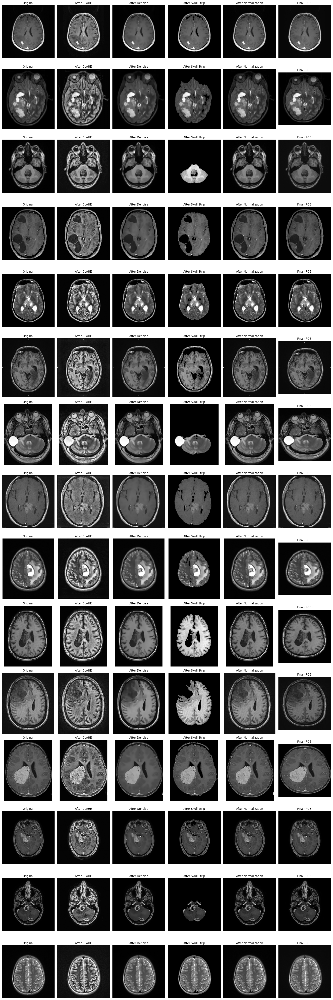

In [16]:
visualize_preprocessing(df)

In [17]:
model = build_model()
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 224, 224,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling           │ (None, 224, 224,  │          0 │ input_layer[0][0] │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ normalization       │ (None, 224, 224,  │          7 │ rescaling[0][0]   │
│ (Normalization)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ rescaling_1         │ (None, 224, 224,  │          0 │ normalization[0]… │
│ (Rescaling)         │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv_pad       │ (None, 225, 225,  │          0 │ rescaling_1[0][0] │
│ (ZeroPadding2D)     │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_conv (Conv2D)  │ (None, 112, 112,  │        864 │ stem_conv_pad[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_bn             │ (None, 112, 112,  │        128 │ stem_conv[0][0]   │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ stem_activation     │ (None, 112, 112,  │          0 │ stem_bn[0][0]     │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_dwconv      │ (None, 112, 112,  │        288 │ stem_activation[… │
│ (DepthwiseConv2D)   │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_bn          │ (None, 112, 112,  │        128 │ block1a_dwconv[0… │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_activation  │ (None, 112, 112,  │          0 │ block1a_bn[0][0]  │
│ (Activation)        │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_squeeze  │ (None, 32)        │          0 │ block1a_activati… │
│ (GlobalAveragePool… │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reshape  │ (None, 1, 1, 32)  │          0 │ block1a_se_squee… │
│ (Reshape)           │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_reduce   │ (None, 1, 1, 8)   │        264 │ block1a_se_resha… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_expand   │ (None, 1, 1, 32)  │        288 │ block1a_se_reduc… │
│ (Conv2D)            │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_se_excite   │ (None, 112, 112,  │          0 │ block1a_activati… │
│ (Multiply)          │ 32)               │            │ block1a_se_expan… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ block1a_project_co… │ (None, 112, 112,  │        512 │ block1a_se_excit

 Total params: 4,412,338 (16.83 MB)

 Trainable params: 362,767 (1.38 MB)

 Non-trainable params: 4,049,571 (15.45 MB)

Found 3125 validated image filenames belonging to 15 classes.
Found 670 validated image filenames belonging to 15 classes.
Found 670 validated image filenames belonging to 15 classes.

Building model...

Training model with base preprocessing...
Epoch 1/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 42s 188ms/step - accuracy: 0.2128 - loss: 2.4484 - precision: 0.4000 - recall: 0.0032 - val_accuracy: 0.3269 - val_loss: 2.0994 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 1.0000e-04
Epoch 2/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 36s 184ms/step - accuracy: 0.3075 - loss: 2.1564 - precision: 0.5548 - recall: 0.0275 - val_accuracy: 0.4000 - val_loss: 1.9032 - val_precision: 0.7966 - val_recall: 0.0701 - learning_rate: 1.0000e-04
Epoch 3/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 37s 189ms/step - accuracy: 0.3501 - loss: 2.0177 - precision: 0.5893 - recall: 0.0634 - val_accuracy: 0.4567 - val_loss: 1.7623 - val_precision: 0.7449 - val_recall: 0.1090 - learning_rate: 1.0000e-04
Epoch 4/500
196/196 

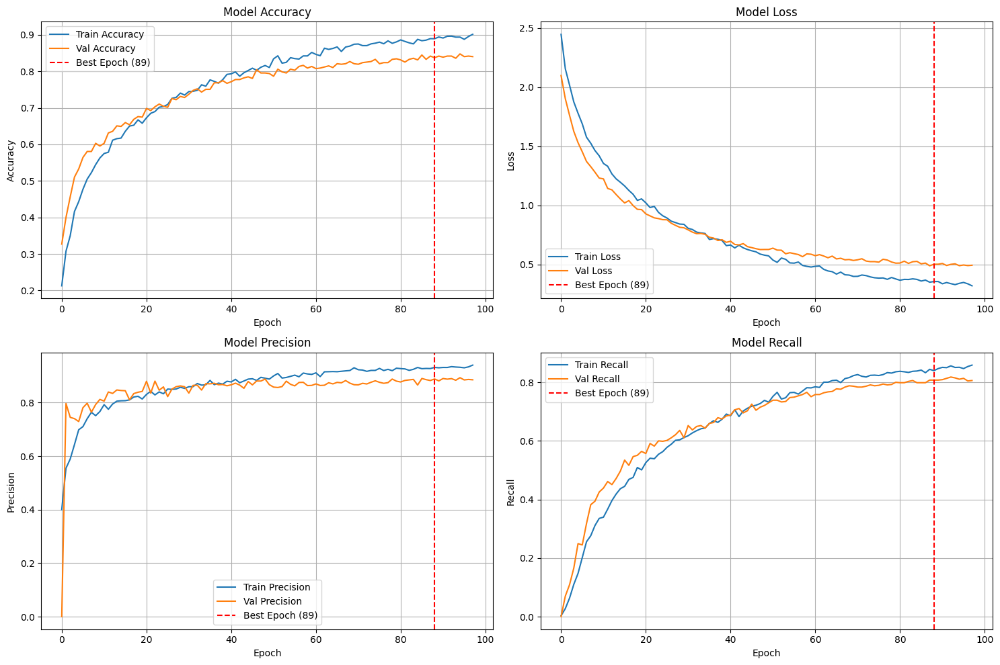


Evaluating model...
42/42 ━━━━━━━━━━━━━━━━━━━━ 8s 168ms/step

Classification Report:
                   precision    recall  f1-score   support

      Astrocitoma       0.89      0.86      0.88        87
        Carcinoma       1.00      0.95      0.97        37
       Ependimoma       1.00      0.86      0.93        22
    Ganglioglioma       0.78      0.78      0.78         9
        Germinoma       0.82      0.64      0.72        14
     Glioblastoma       0.77      0.77      0.77        31
        Granuloma       1.00      0.83      0.91        12
   Meduloblastoma       0.70      0.84      0.76        19
       Meningioma       0.84      0.87      0.85       131
           NORMAL       0.89      0.91      0.90        79
      Neurocitoma       0.87      0.96      0.91        68
Oligodendroglioma       0.90      0.79      0.84        33
         Papiloma       0.95      0.97      0.96        36
       Schwannoma       0.89      0.94      0.92        70
      Tuberculoma       1.00

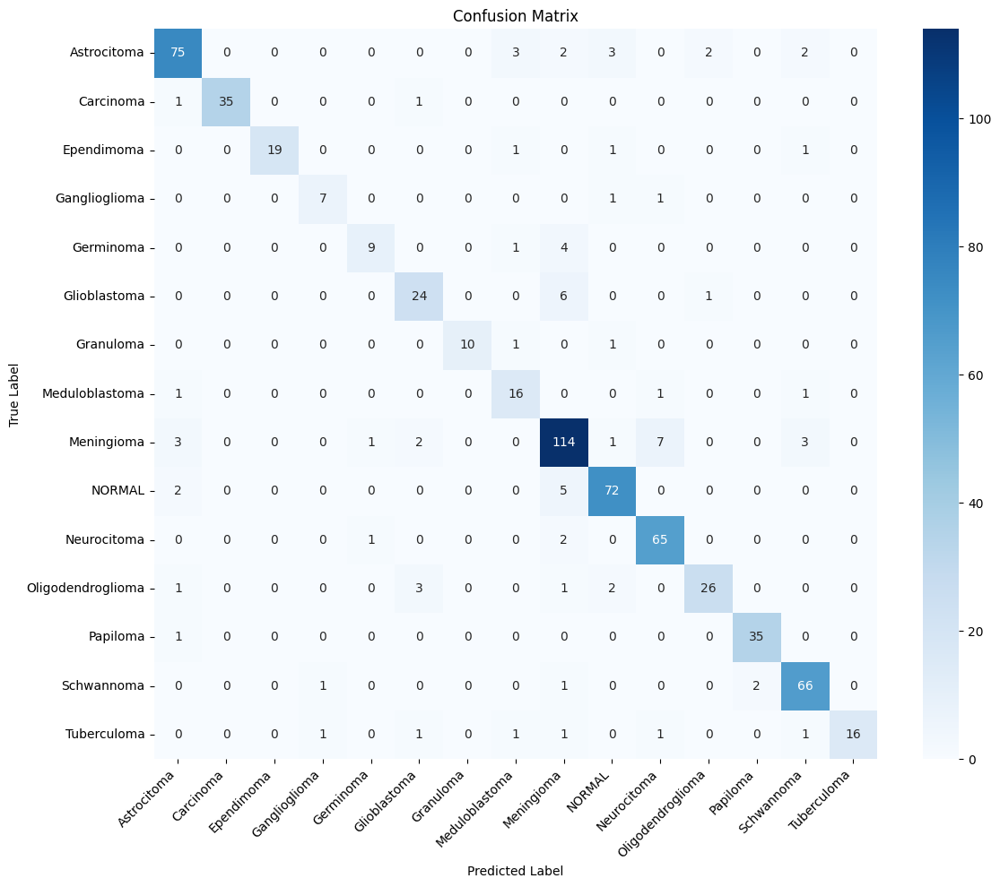


Hasil Evaluasi:
Accuracy: 0.8791
Average Precision: 0.8858
Average Recall: 0.8473
F1-Score: 0.8661
Using layer 'top_activation' for Grad-CAM
Activation threshold: 0.5 (Red/Yellow = High importance)


/home/filkom/nada_tif/venv/lib/python3.13/site-packages/keras/src/models/functional.py:241: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor_244']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


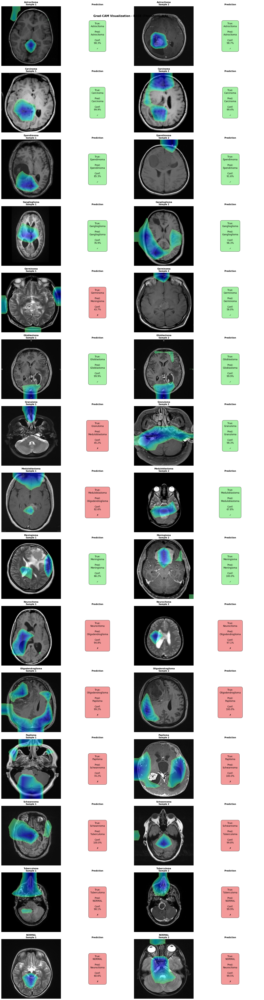

In [18]:
preprocess = "base"
train_generator, val_generator, test_generator = create_data_generators(df.copy(), preprocess)
    
# Build model
print(f"\nBuilding model...")
model = build_model()
    
# Train model
print(f"\nTraining model with {preprocess} preprocessing...")
model, history, best_epoch = compile_and_train_model(
    model,
    train_generator,
    val_generator,
    epochs=config.EPOCHS
)
    
# Plot training history
plot_training_history(history, best_epoch)
    
# Evaluate model
print("\nEvaluating model...")
metrics = evaluate_model(model, test_generator)

visualize_gradcam_preprocessing(df[df['split'] == 'test'], model, preprocess, threshold=0.5)

model.save(f'{preprocess}.h5')

Found 3125 validated image filenames belonging to 15 classes.
Found 670 validated image filenames belonging to 15 classes.
Found 670 validated image filenames belonging to 15 classes.

Building model...

Training model with clahe preprocessing...
Epoch 1/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 46s 200ms/step - accuracy: 0.2022 - loss: 2.5016 - precision: 0.3704 - recall: 0.0032 - val_accuracy: 0.3060 - val_loss: 2.1996 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 1.0000e-04
Epoch 2/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 37s 189ms/step - accuracy: 0.3069 - loss: 2.1900 - precision: 0.5333 - recall: 0.0230 - val_accuracy: 0.3507 - val_loss: 2.0220 - val_precision: 0.6471 - val_recall: 0.0164 - learning_rate: 1.0000e-04
Epoch 3/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 37s 188ms/step - accuracy: 0.3526 - loss: 2.0227 - precision: 0.6181 - recall: 0.0570 - val_accuracy: 0.3821 - val_loss: 1.9072 - val_precision: 0.7619 - val_recall: 0.0716 - learning_rate: 1.0000e-04
Epoch 4/500
196/196

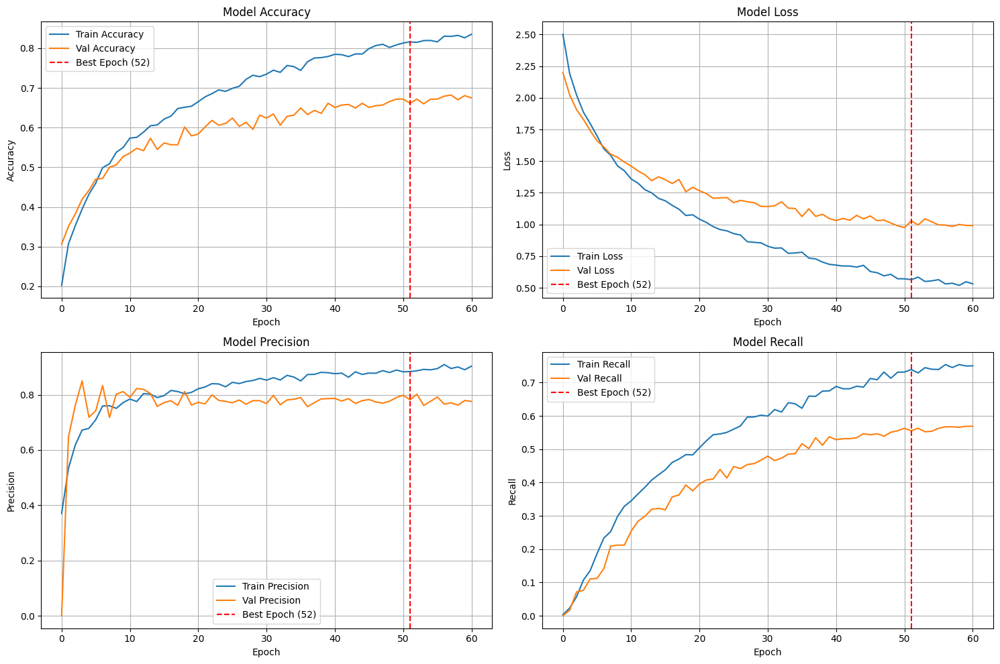


Evaluating model...
42/42 ━━━━━━━━━━━━━━━━━━━━ 8s 161ms/step

Classification Report:
                   precision    recall  f1-score   support

      Astrocitoma       0.61      0.75      0.67        87
        Carcinoma       1.00      0.89      0.94        37
       Ependimoma       0.60      0.27      0.38        22
    Ganglioglioma       0.38      0.67      0.48         9
        Germinoma       0.47      0.50      0.48        14
     Glioblastoma       0.72      0.58      0.64        31
        Granuloma       0.90      0.75      0.82        12
   Meduloblastoma       0.32      0.89      0.47        19
       Meningioma       0.75      0.69      0.72       131
           NORMAL       0.89      0.42      0.57        79
      Neurocitoma       0.75      0.91      0.82        68
Oligodendroglioma       0.65      0.73      0.69        33
         Papiloma       0.94      0.83      0.88        36
       Schwannoma       0.79      0.76      0.77        70
      Tuberculoma       0.61

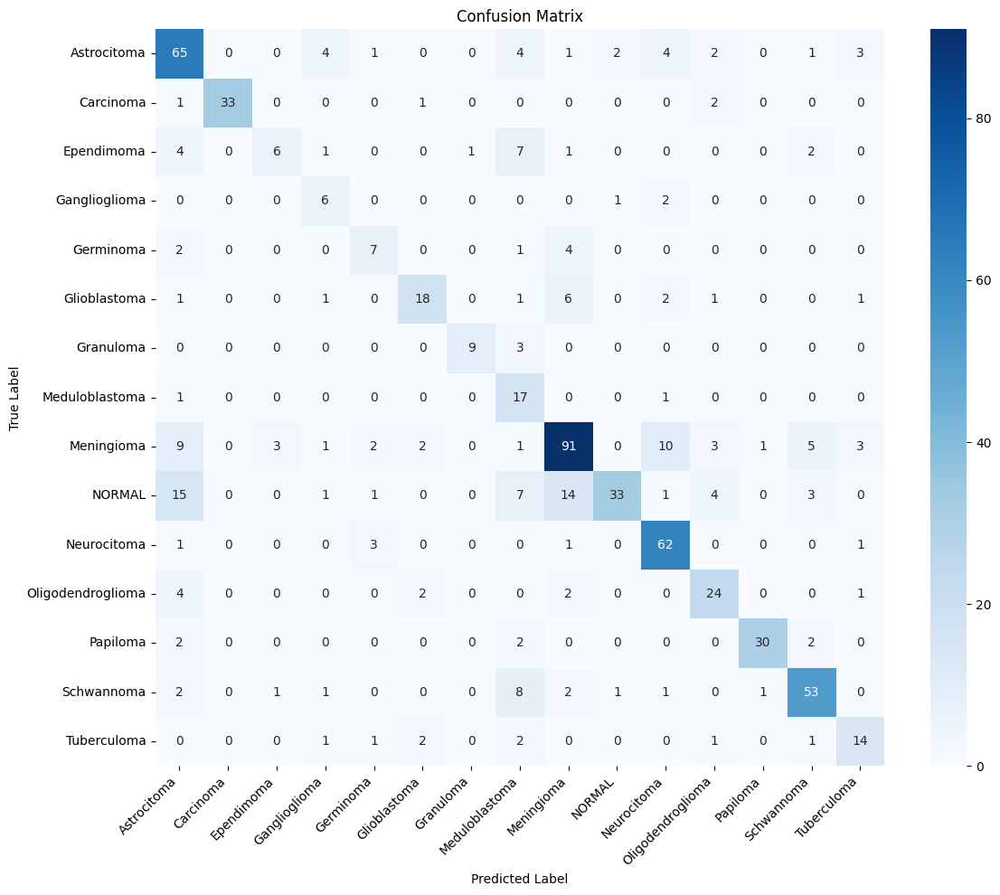


Hasil Evaluasi:
Accuracy: 0.6985
Average Precision: 0.6907
Average Recall: 0.6855
F1-Score: 0.6881
Using layer 'top_activation' for Grad-CAM
Activation threshold: 0.5 (Red/Yellow = High importance)


/home/filkom/nada_tif/venv/lib/python3.13/site-packages/keras/src/models/functional.py:241: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor_494']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


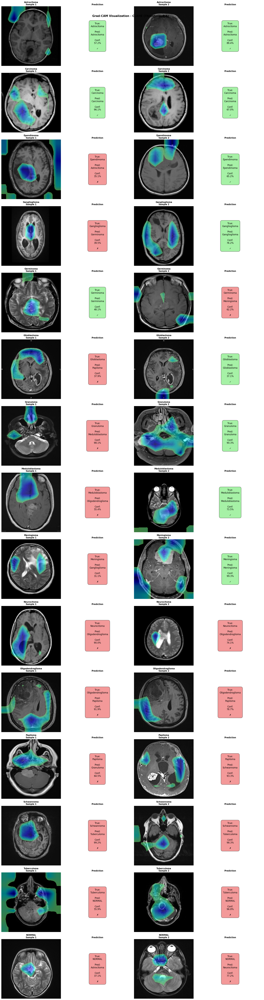

In [19]:
preprocess = "clahe"
train_generator, val_generator, test_generator = create_data_generators(df.copy(), preprocess)
    
# Build model
print(f"\nBuilding model...")
model = build_model()
    
# Train model
print(f"\nTraining model with {preprocess} preprocessing...")
model, history, best_epoch = compile_and_train_model(
    model,
    train_generator,
    val_generator,
    epochs=config.EPOCHS
)
    
# Plot training history
plot_training_history(history, best_epoch)
    
# Evaluate model
print("\nEvaluating model...")
metrics = evaluate_model(model, test_generator)

visualize_gradcam_preprocessing(df[df['split'] == 'test'], model, preprocess, threshold=0.5)

model.save(f'{preprocess}.h5')

Found 3125 validated image filenames belonging to 15 classes.
Found 670 validated image filenames belonging to 15 classes.
Found 670 validated image filenames belonging to 15 classes.

Building model...

Training model with denoise preprocessing...
Epoch 1/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 139s 676ms/step - accuracy: 0.2112 - loss: 2.4285 - precision: 0.5000 - recall: 0.0022 - val_accuracy: 0.3239 - val_loss: 2.2440 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 1.0000e-04
Epoch 2/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 131s 668ms/step - accuracy: 0.3165 - loss: 2.1560 - precision: 0.5676 - recall: 0.0269 - val_accuracy: 0.3418 - val_loss: 2.1073 - val_precision: 0.8750 - val_recall: 0.0209 - learning_rate: 1.0000e-04
Epoch 3/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 131s 670ms/step - accuracy: 0.3610 - loss: 2.0021 - precision: 0.6640 - recall: 0.0784 - val_accuracy: 0.3433 - val_loss: 2.0051 - val_precision: 0.7160 - val_recall: 0.0866 - learning_rate: 1.0000e-04
Epoch 4/500
19

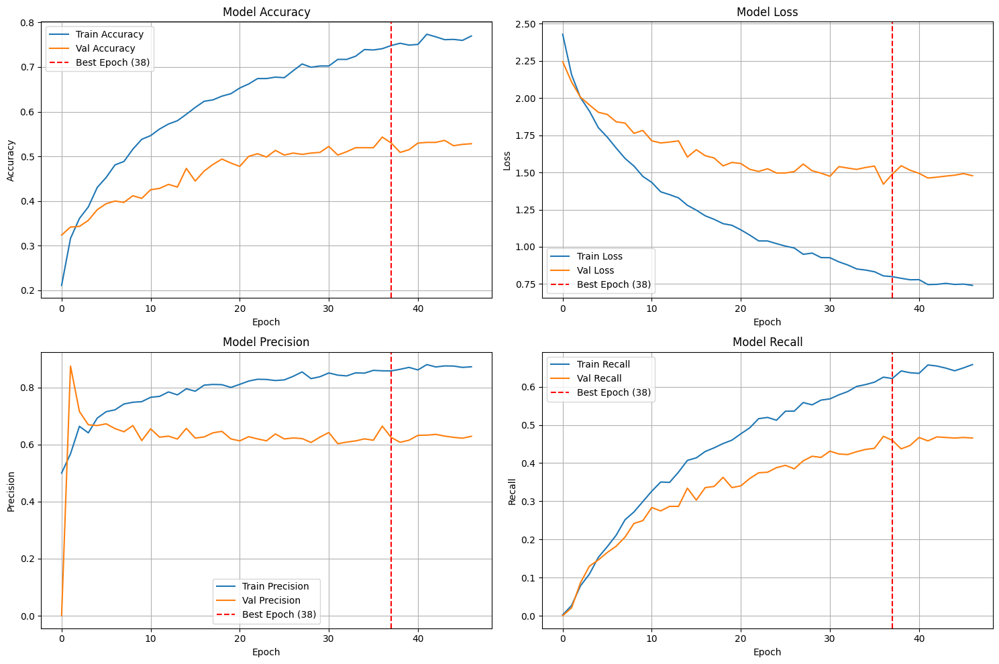


Evaluating model...
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step

Classification Report:
                   precision    recall  f1-score   support

      Astrocitoma       0.81      0.34      0.48        87
        Carcinoma       1.00      0.27      0.43        37
       Ependimoma       0.67      0.09      0.16        22
    Ganglioglioma       1.00      0.11      0.20         9
        Germinoma       0.00      0.00      0.00        14
     Glioblastoma       0.27      0.48      0.34        31
        Granuloma       0.50      0.25      0.33        12
   Meduloblastoma       0.62      0.42      0.50        19
       Meningioma       0.64      0.60      0.62       131
           NORMAL       0.51      0.95      0.66        79
      Neurocitoma       0.60      0.81      0.69        68
Oligodendroglioma       0.33      0.42      0.37        33
         Papiloma       0.86      0.67      0.75        36
       Schwannoma       0.55      0.81      0.66        70
      Tuberculoma       0.75 

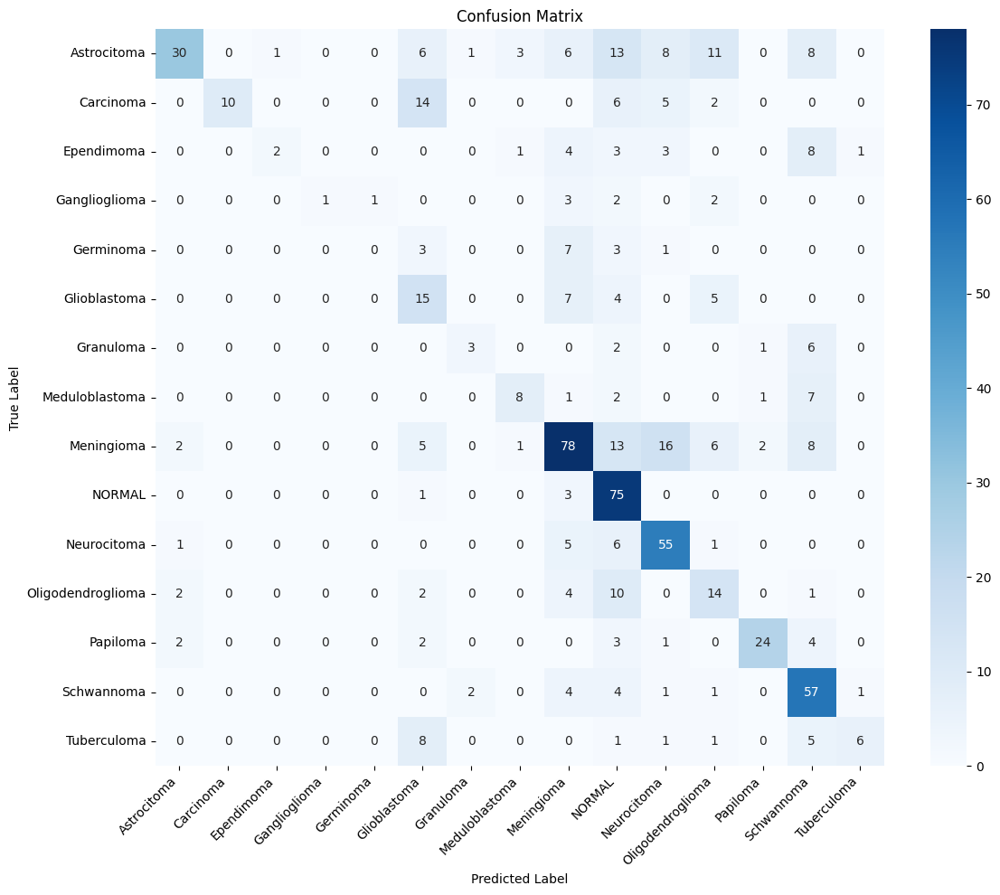


Hasil Evaluasi:
Accuracy: 0.5642
Average Precision: 0.6064
Average Recall: 0.4336
F1-Score: 0.5056
Using layer 'top_activation' for Grad-CAM
Activation threshold: 0.5 (Red/Yellow = High importance)


/home/filkom/nada_tif/venv/lib/python3.13/site-packages/keras/src/models/functional.py:241: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor_744']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


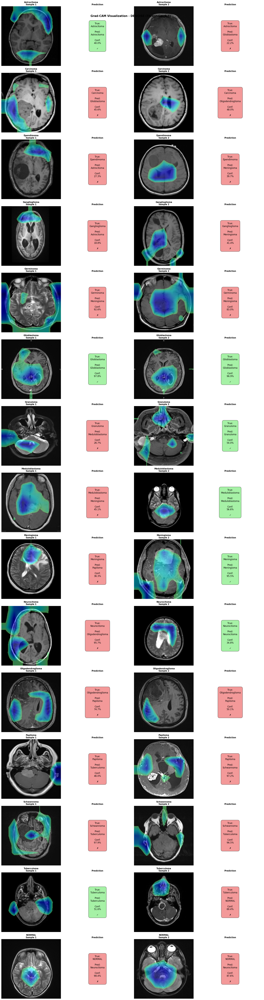

In [20]:
preprocess = "denoise"
train_generator, val_generator, test_generator = create_data_generators(df.copy(), preprocess)
    
# Build model
print(f"\nBuilding model...")
model = build_model()
    
# Train model
print(f"\nTraining model with {preprocess} preprocessing...")
model, history, best_epoch = compile_and_train_model(
    model,
    train_generator,
    val_generator,
    epochs=config.EPOCHS
)
    
# Plot training history
plot_training_history(history, best_epoch)
    
# Evaluate model
print("\nEvaluating model...")
metrics = evaluate_model(model, test_generator)

visualize_gradcam_preprocessing(df[df['split'] == 'test'], model, preprocess, threshold=0.5)

model.save(f'{preprocess}.h5')

Found 3125 validated image filenames belonging to 15 classes.
Found 670 validated image filenames belonging to 15 classes.
Found 670 validated image filenames belonging to 15 classes.

Building model...

Training model with skull_stripping preprocessing...
Epoch 1/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 30s 136ms/step - accuracy: 0.1814 - loss: 2.5162 - precision: 0.7000 - recall: 0.0022 - val_accuracy: 0.2328 - val_loss: 2.3049 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 1.0000e-04
Epoch 2/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 26s 132ms/step - accuracy: 0.3008 - loss: 2.1989 - precision: 0.7049 - recall: 0.0275 - val_accuracy: 0.2866 - val_loss: 2.1707 - val_precision: 0.7500 - val_recall: 0.0090 - learning_rate: 1.0000e-04
Epoch 3/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 26s 132ms/step - accuracy: 0.3574 - loss: 2.0131 - precision: 0.6559 - recall: 0.0781 - val_accuracy: 0.2910 - val_loss: 2.0956 - val_precision: 0.8889 - val_recall: 0.0358 - learning_rate: 1.0000e-04
Epoch 4/5

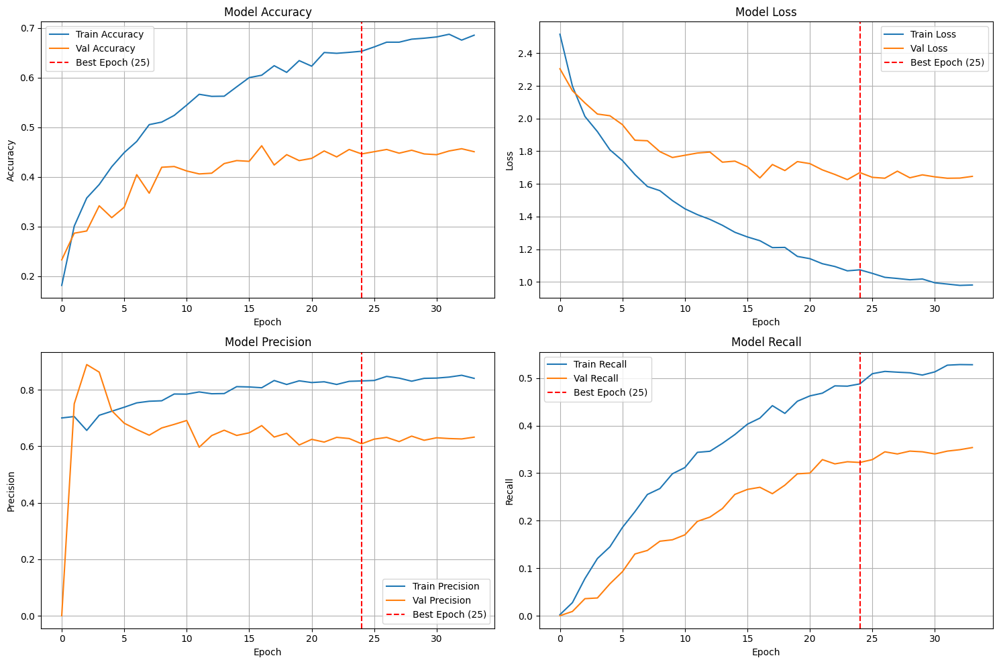


Evaluating model...
42/42 ━━━━━━━━━━━━━━━━━━━━ 5s 102ms/step

Classification Report:
                   precision    recall  f1-score   support

      Astrocitoma       0.37      0.71      0.49        87
        Carcinoma       1.00      0.30      0.46        37
       Ependimoma       0.00      0.00      0.00        22
    Ganglioglioma       0.00      0.00      0.00         9
        Germinoma       0.60      0.21      0.32        14
     Glioblastoma       0.35      0.26      0.30        31
        Granuloma       0.00      0.00      0.00        12
   Meduloblastoma       0.17      0.53      0.26        19
       Meningioma       0.40      0.71      0.51       131
           NORMAL       0.71      0.30      0.42        79
      Neurocitoma       0.84      0.71      0.77        68
Oligodendroglioma       1.00      0.18      0.31        33
         Papiloma       0.62      0.64      0.63        36
       Schwannoma       0.68      0.36      0.47        70
      Tuberculoma       0.50

/home/filkom/nada_tif/venv/lib/python3.13/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/filkom/nada_tif/venv/lib/python3.13/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result.shape[0])
/home/filkom/nada_tif/venv/lib/python3.13/site-packages/sklearn/metrics/_classification.py:1731: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", result

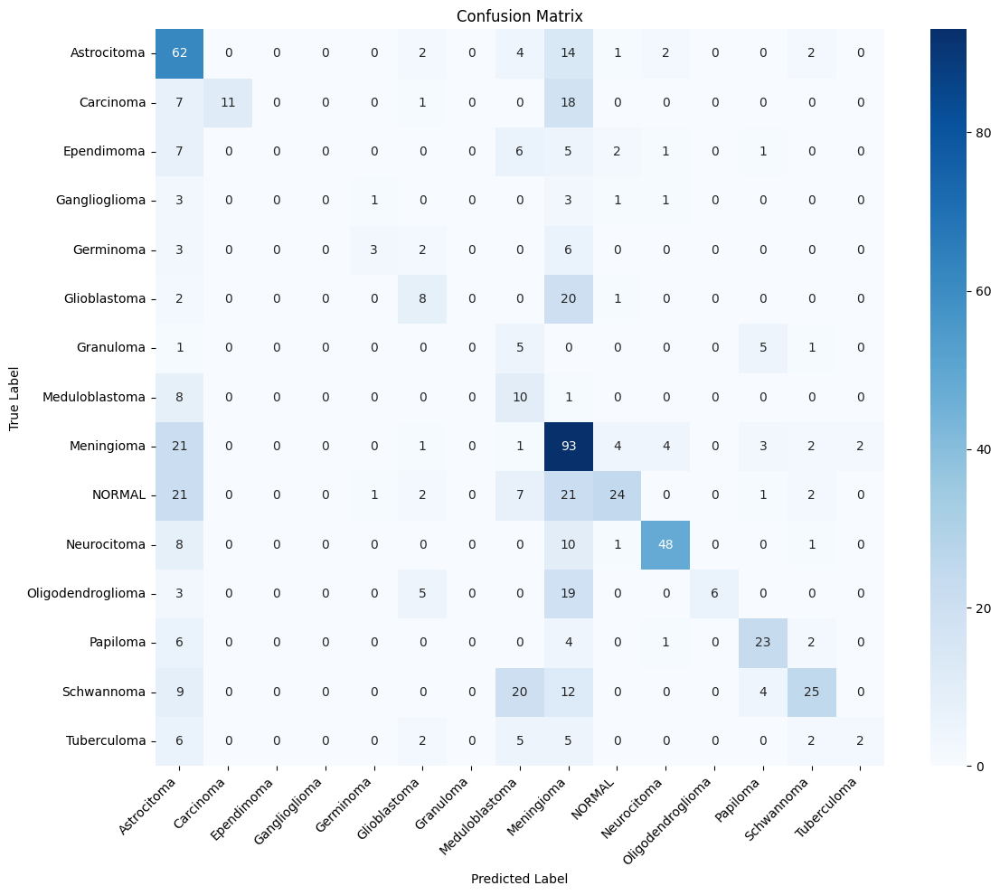


Hasil Evaluasi:
Accuracy: 0.4701
Average Precision: 0.4826
Average Recall: 0.3331
F1-Score: 0.3942
Using layer 'top_activation' for Grad-CAM
Activation threshold: 0.5 (Red/Yellow = High importance)


/home/filkom/nada_tif/venv/lib/python3.13/site-packages/keras/src/models/functional.py:241: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor_994']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


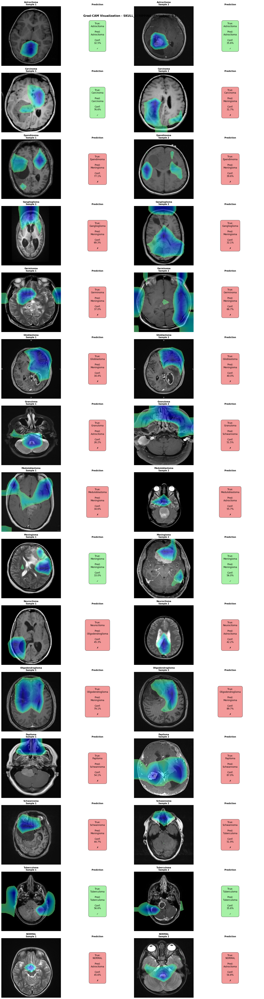

In [21]:
preprocess = "skull_stripping"
train_generator, val_generator, test_generator = create_data_generators(df.copy(), preprocess)
    
# Build model
print(f"\nBuilding model...")
model = build_model()
    
# Train model
print(f"\nTraining model with {preprocess} preprocessing...")
model, history, best_epoch = compile_and_train_model(
    model,
    train_generator,
    val_generator,
    epochs=config.EPOCHS
)
    
# Plot training history
plot_training_history(history, best_epoch)
    
# Evaluate model
print("\nEvaluating model...")
metrics = evaluate_model(model, test_generator)

visualize_gradcam_preprocessing(df[df['split'] == 'test'], model, preprocess, threshold=0.5)

model.save(f'{preprocess}.h5')

Found 3125 validated image filenames belonging to 15 classes.
Found 670 validated image filenames belonging to 15 classes.
Found 670 validated image filenames belonging to 15 classes.

Building model...

Training model with intensity_normalization preprocessing...
Epoch 1/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 29s 133ms/step - accuracy: 0.1914 - loss: 2.4954 - precision: 0.6667 - recall: 0.0019 - val_accuracy: 0.3522 - val_loss: 2.1813 - val_precision: 0.0000e+00 - val_recall: 0.0000e+00 - learning_rate: 1.0000e-04
Epoch 2/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 25s 128ms/step - accuracy: 0.2986 - loss: 2.2028 - precision: 0.5809 - recall: 0.0253 - val_accuracy: 0.3985 - val_loss: 1.9637 - val_precision: 0.9333 - val_recall: 0.0209 - learning_rate: 1.0000e-04
Epoch 3/500
196/196 ━━━━━━━━━━━━━━━━━━━━ 25s 128ms/step - accuracy: 0.3587 - loss: 2.0183 - precision: 0.6454 - recall: 0.0646 - val_accuracy: 0.4179 - val_loss: 1.8180 - val_precision: 0.7875 - val_recall: 0.0940 - learning_rate: 1.0000e-04
E

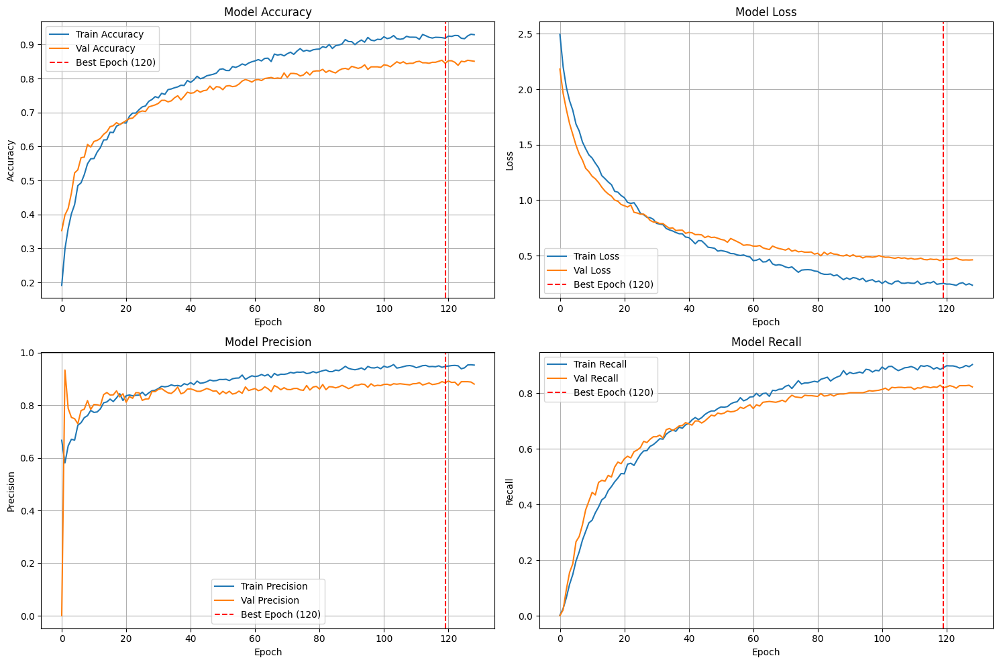


Evaluating model...
42/42 ━━━━━━━━━━━━━━━━━━━━ 4s 86ms/step

Classification Report:
                   precision    recall  f1-score   support

      Astrocitoma       0.88      0.87      0.88        87
        Carcinoma       1.00      0.95      0.97        37
       Ependimoma       0.86      0.86      0.86        22
    Ganglioglioma       0.88      0.78      0.82         9
        Germinoma       0.92      0.86      0.89        14
     Glioblastoma       0.78      0.81      0.79        31
        Granuloma       1.00      0.83      0.91        12
   Meduloblastoma       0.79      0.79      0.79        19
       Meningioma       0.85      0.90      0.87       131
           NORMAL       0.89      0.90      0.89        79
      Neurocitoma       0.93      0.97      0.95        68
Oligodendroglioma       0.93      0.85      0.89        33
         Papiloma       0.95      0.97      0.96        36
       Schwannoma       0.90      0.89      0.89        70
      Tuberculoma       0.95 

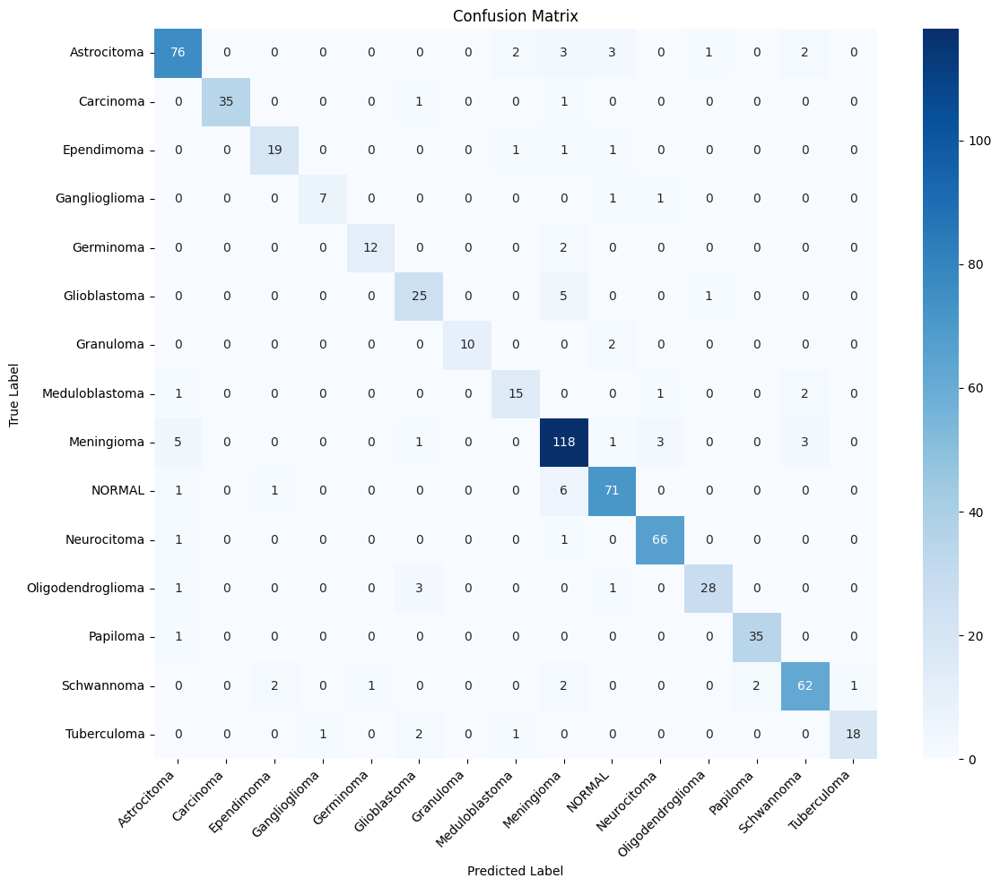


Hasil Evaluasi:
Accuracy: 0.8910
Average Precision: 0.9005
Average Recall: 0.8695
F1-Score: 0.8847
Using layer 'top_activation' for Grad-CAM
Activation threshold: 0.5 (Red/Yellow = High importance)


/home/filkom/nada_tif/venv/lib/python3.13/site-packages/keras/src/models/functional.py:241: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: [['keras_tensor_1244']]
Received: inputs=Tensor(shape=(1, 224, 224, 3))
  warnings.warn(msg)


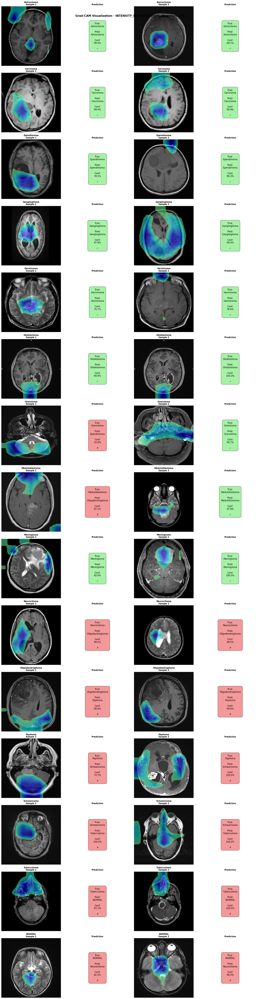

In [22]:
preprocess = "intensity_normalization"
train_generator, val_generator, test_generator = create_data_generators(df.copy(), preprocess)
    
# Build model
print(f"\nBuilding model...")
model = build_model()
    
# Train model
print(f"\nTraining model with {preprocess} preprocessing...")
model, history, best_epoch = compile_and_train_model(
    model,
    train_generator,
    val_generator,
    epochs=config.EPOCHS
)
    
# Plot training history
plot_training_history(history, best_epoch)
    
# Evaluate model
print("\nEvaluating model...")
metrics = evaluate_model(model, test_generator)

visualize_gradcam_preprocessing(df[df['split'] == 'test'], model, preprocess, threshold=0.5)

model.save(f'{preprocess}.h5')